# Introduction

We have analyzed the source code of `nfov` which extracts rectilinear image frame from the panorama and developed the spherical warp function that is the inversed process of the frame extraction. What the `nfov` does is just the opposite of what we are going to do.

So, in this experiment, we are trying to compose a entire panorama from image frames using this inversed code. `Nfov` works quite correctly and we found that our inversed function also works well. If our meta information(RPY and AOV) are correct, and so if this experiment succeed, it would be the completion of our project.

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
import json    
from tqdm import tqdm_notebook

import math
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.transforms as mptrans

from scipy import ndimage

import cv2 as cv
import imutils

import gc

In [3]:
from libpano import MetaData
from libpano import utils
from libpano import warpers
from libpano.ImageCropper import ImageCropper

### Load and parse meta data

In [4]:
ID = 'recent-04'
IMAGE_FOLDER = '../images/' + ID + '/'
JSON_FN = IMAGE_FOLDER + ID + '.json'

In [5]:
meta_data = MetaData.MetaData(IMAGE_FOLDER)
metrics = meta_data.metrics
meta = meta_data.grid_data

This is the camera metrics we calculated from the camera metrics information in JSON file.

In [6]:
print(metrics)

Camera Metrics:
	Focal Length: 4.4589 mm
	Focal Length: 1588.26 px
	Sensor Size: 4.2447996 x 5.6447997 mm
	Pixels per mm: 356.20 x 357.14 px
PanoramaMetrics:
	Frame Count: 15 x 5
	Frame Size: 1512px x 2016px
	Interval Angle: 24.0︒ x 36.0︒
	AoV: 50.9081︒ x 64.6661︒
	AoV: 0.8885 x 1.1286
	PPR: 1701.7168px x 1786.2268px
	Panorama Size: 10692.2019px x 5611.5971px



metrics.AOV_v = 0.95
metrics.AOV_h = 0.8

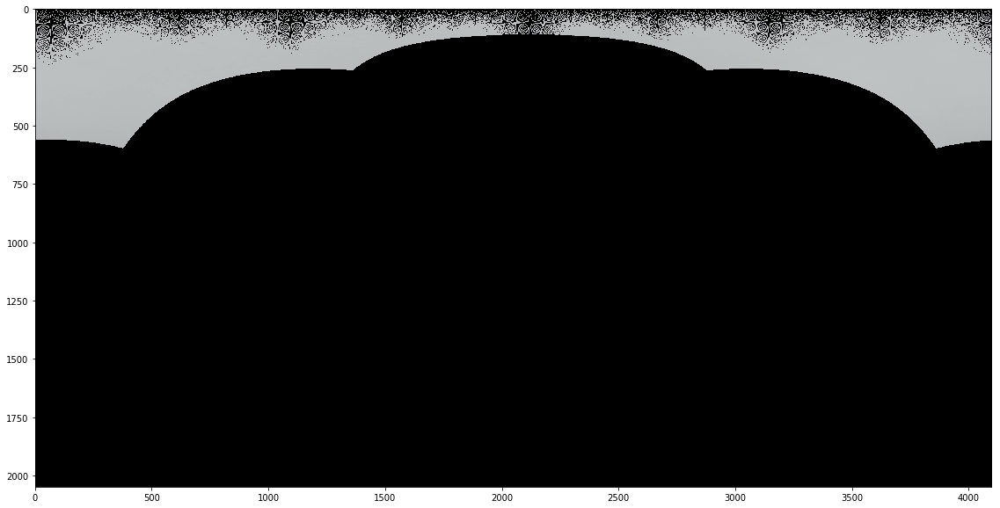

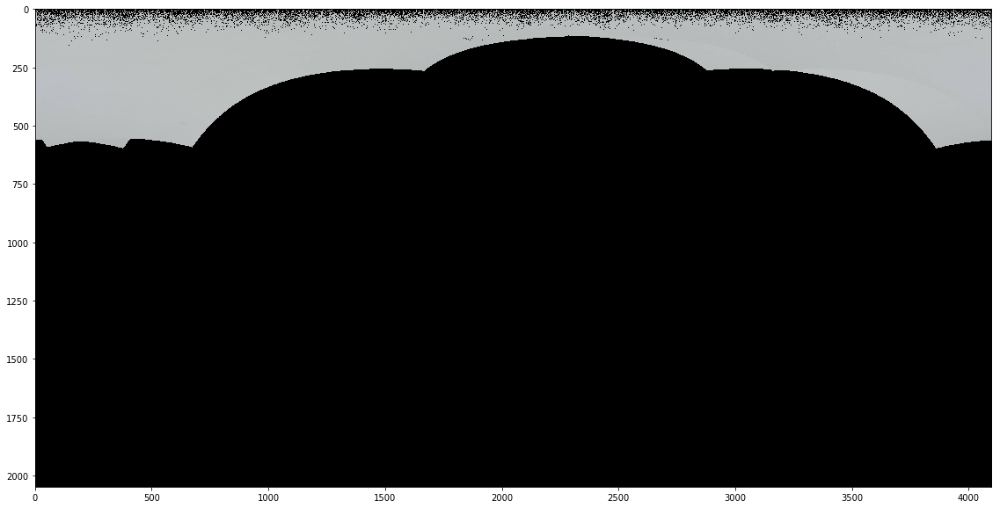

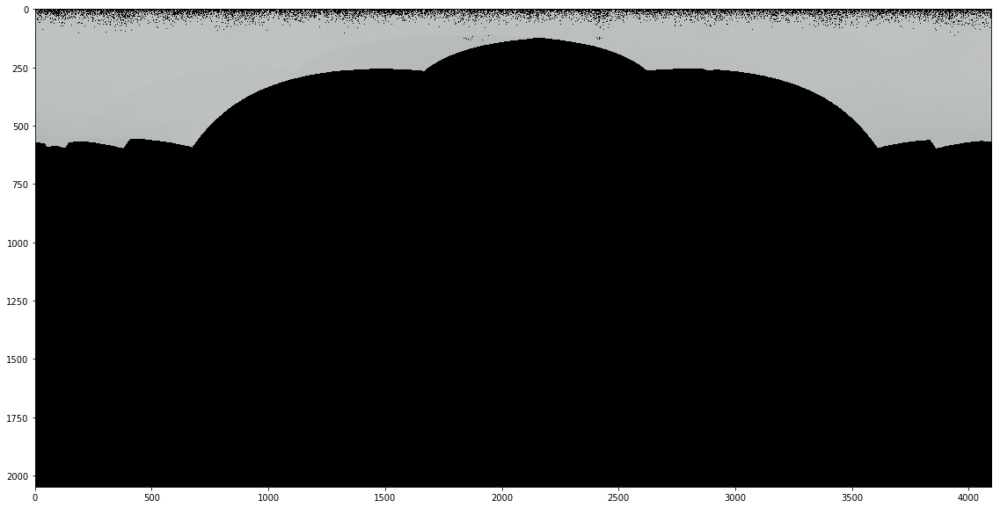

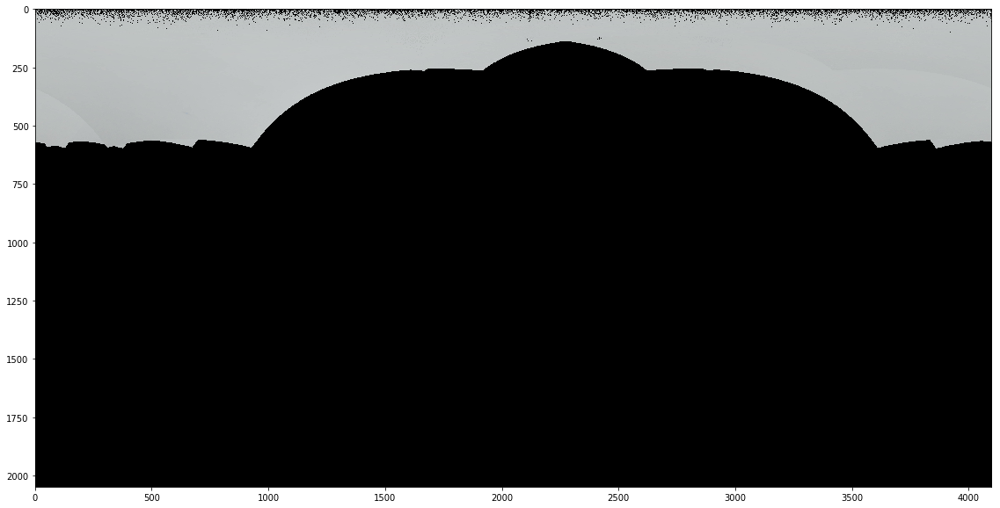

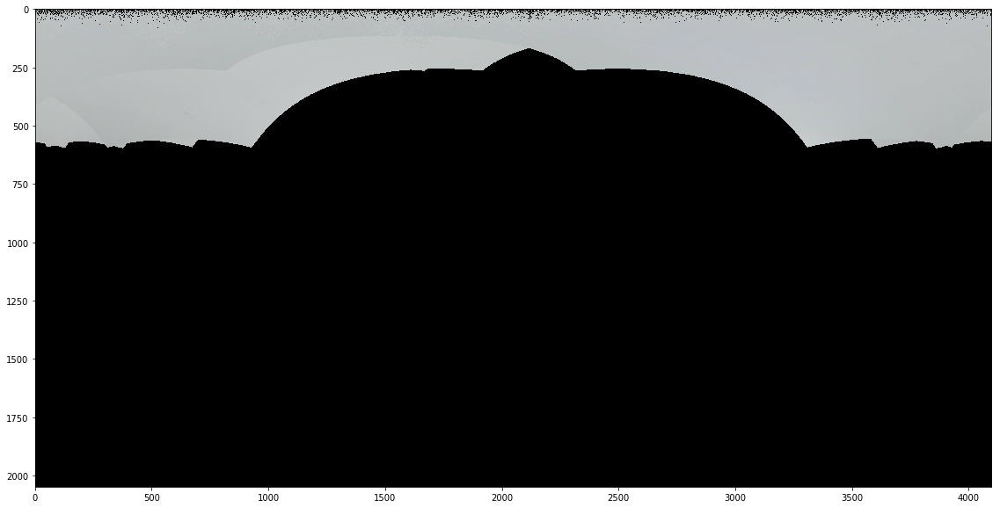

...

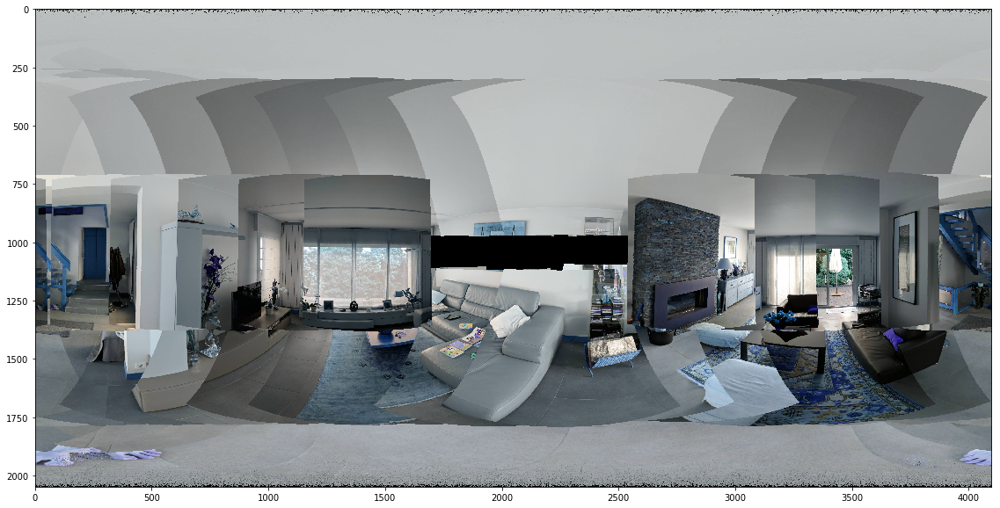

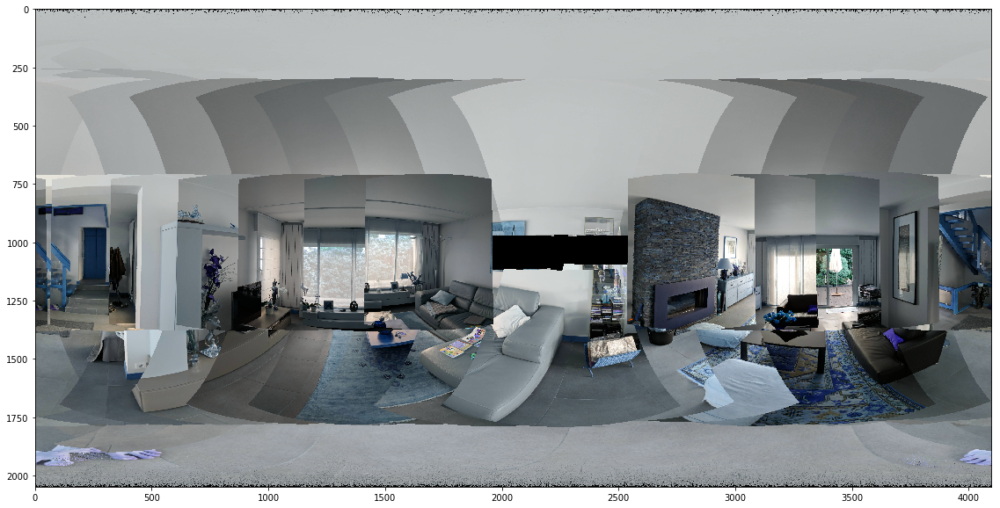

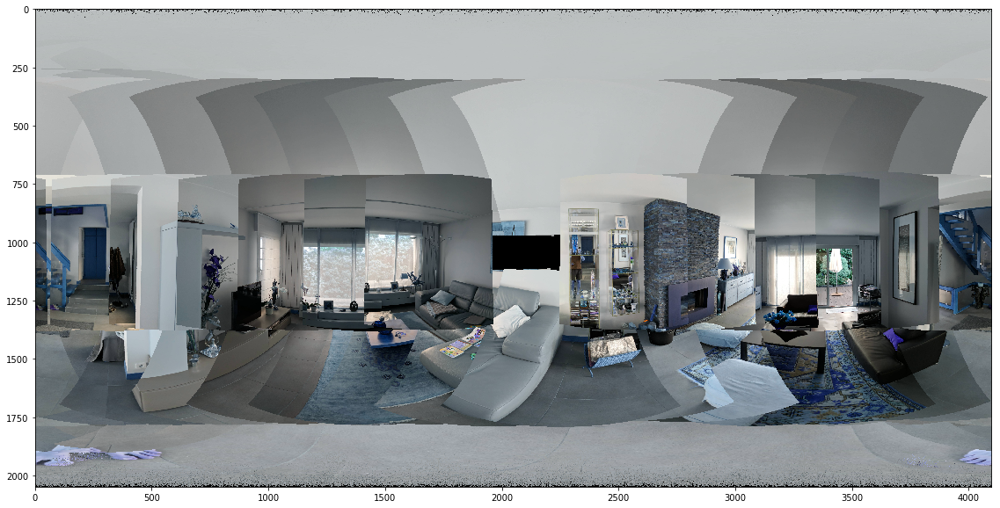

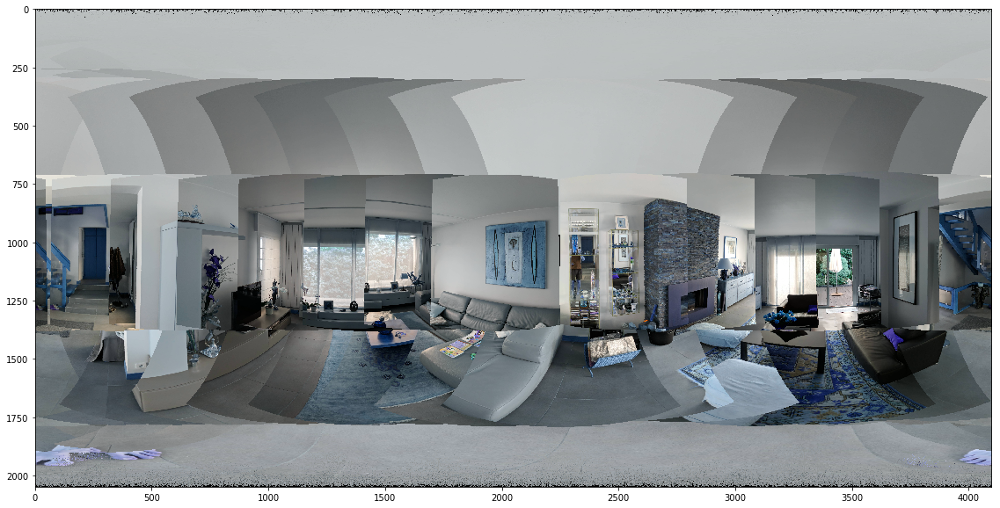

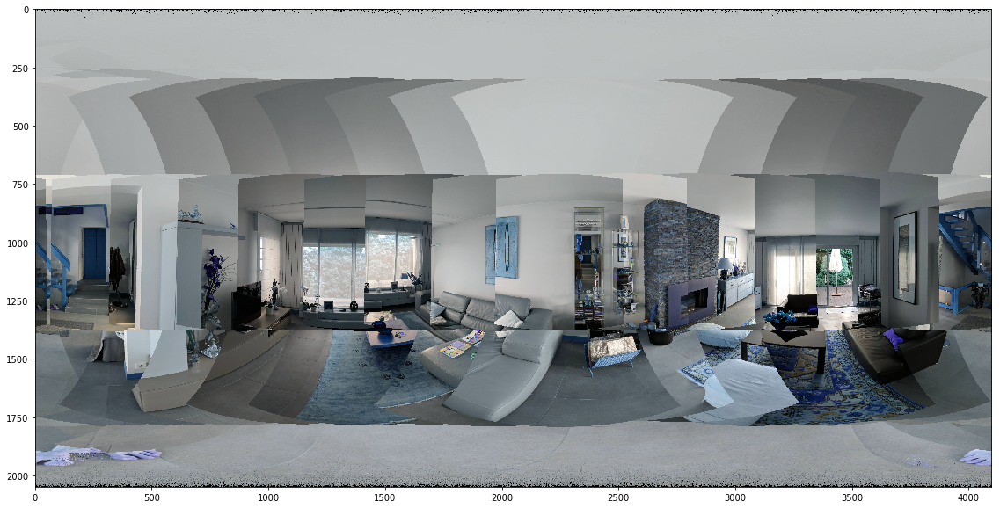

In [7]:
rows = [0, 4, 1, 3, 2]
cols = [7, 8, 6, 9, 5, 10, 4, 11, 3, 12, 2, 13, 1, 14, 0]

pano_canvas = np.zeros((2048, 4096, 3), np.float)

for row in rows:
    for col in cols:
        frame_row = meta.loc[(meta.row == row) & (meta.col == col)]
        
        p = utils.degree2radian(frame_row['pitch'].iloc[0])
        y = utils.degree2radian(frame_row['yaw'].iloc[0])
        roll = frame_row['roll'].iloc[0]        
        
        img = cv.imread(IMAGE_FOLDER + frame_row['uri'].iloc[0])
        
        # rotate image
        orig_height, orig_width, _ = img.shape
        img = imutils.rotate_bound(img, roll)

        # crop image boundaries
        cropper = ImageCropper(img)
        img = cropper.crop()

        # resize the image to the original
        img = cv.resize(img, (orig_width, orig_height), interpolation=cv.INTER_LINEAR_EXACT)
        
        pano_canvas, warped = warpers.render_image_to_canvas(pano_canvas, img, p, y, metrics)
        cv.imwrite('warped/warped-{}-{}.jpg'.format(row, col), warped)
        
        plt.figure(figsize=(30, 10))
        plt.imshow(pano_canvas)
        plt.show()

In [8]:
cv.imwrite('render-result-1.jpg', pano_canvas)

True

# Conclusion

From the experiment above, I've got the following conclusion:

#### 1. We can't believe the RPY values as well as AOV values.
    I tried many times to change AOV values manually but the results were not better.
#### 2. Inversed rectilinear projection is not the correct way to compose the panorama.
    It is possible and has no rist to extract rectilinear image tile from any completed panorama. If we have a perfect set of image tiles, the inverse process would succeed. But the image pieces we have are not perfect: they have different sizes and directions for even the same object, some objects are hidden behind others in a frame while are visible in other image pieces.


